# Exploratory Training Data Analysis
- Identifying features > 25% missing to remove
- Identifying extremely correlating features to remove
- Plotting distributions of features
- Plotting selected features by BorutaShap (correlation, covariance, distribution, mutual information, pairwise plots)
- Pairwise-dependence plots of selected features by BorutaShap and their feature-feature interactions.
- Visualization of unsupervised learning (training data groupings in hierarchical clustering and silhoutte plots)

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.io as pio
from pdpbox import get_dataset, info_plots, pdp

%matplotlib inline
%config InlineBackend.figure_format ='retina'

pio.renderers.default = "notebook"
import plotly.figure_factory as ff
import plotly.offline as py

import sys
import sklearn.neighbors._base
sys.modules['sklearn.neighbors.base'] = sklearn.neighbors._base

py.init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import missingno as msno
import numpy
import plotly.graph_objs as go
import plotly.tools as tls
import scipy.cluster.hierarchy as hcluster
import scipy.cluster.hierarchy as shc
from missingpy import MissForest
from plotnine import *
from scipy.cluster.hierarchy import dendrogram, ward
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.feature_selection import f_regression, mutual_info_regression
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use("ggplot")
import seaborn as sns
from matplotlib import pyplot
from pdpbox import get_dataset, info_plots, pdp
from sklearn.ensemble import (
    BaggingRegressor,
    GradientBoostingRegressor,
    RandomForestRegressor,
    StackingRegressor,
    VotingRegressor,
)
from sklearn.feature_selection import SelectKBest, mutual_info_regression
from sklearn.model_selection import train_test_split

sns.set_style("darkgrid")
sns.mpl.rcParams["figure.figsize"] = (15.0, 9.0)

import re

from scipy.cluster.hierarchy import dendrogram, linkage

regex = re.compile(r"\[|\]|<", re.IGNORECASE)

import gc
import warnings

warnings.filterwarnings("ignore")

import xgboost
from sklearn.model_selection import train_test_split

seed = 0

In [2]:
dataset = pd.read_csv("4l_training_data.txt", sep="\t")
dataset = dataset.rename({"IPA_BP": "IPA_BP_annotation"}, axis=1)
dataset.shape

(377, 176)

In [3]:
data = dataset.drop(["Gene"], 1)
print(data.shape)

(377, 175)


In [4]:
data["BPlabel_encoded"] = data["BPlabel"].map(
    {"most likely": 1, "probable": 0.75,"possible":0.5, "least likely": 0.1}
)
Y = data["BPlabel_encoded"]

In [5]:
data.describe()

,REVEL.max,MetaSVM_rankscore.max,MetaLR_rankscore.max,MCAP.max,wgEncodeBroadHmmHuvecHMM.count,betamax,logpval_gwascatalog,Adipose - Subcutaneous_GTExTPM,Adipose - Visceral (Omentum)_GTExTPM,Adrenal Gland_GTExTPM,...,fathmm-MKL_coding_score,integrated_fitCons_score,GERP_Rankscore,interaction,SignalValue_H3k27me3_median,SignalValue_H3k9ac_median,SignalValue_H3k9me1_median,H4k20me1_count,SignalValue_H4k20me1_median,BPlabel_encoded
count,106.000000,97.000000,97.000000,0.0,377.000000,357.000000,279.000000,334.000000,334.000000,334.000000,...,111.000000,111.000000,109.000000,0.0,219.000000,257.000000,250.000000,209.000000,209.000000,377.000000
mean,0.156358,0.408124,0.160093,NaN,235.275862,0.004296,80.845868,49.634444,43.715065,75.216873,...,0.815074,0.636691,0.619952,NaN,4.662292,15.889968,1.799929,245.459330,2.567972,0.568833
std,0.133446,0.219785,0.277829,NaN,543.569089,0.425229,258.044096,170.248361,150.885481,509.437695,...,0.288694,0.122363,0.275681,NaN,5.271108,12.195681,1.309913,564.465625,2.010488,0.305082
min,0.011000,0.043000,0.000000,NaN,1.000000,-1.383800,5.096910,0.000000,0.000000,0.000000,...,0.003360,0.067858,0.007760,NaN,1.288480,2.059690,1.070290,1.000000,1.084560,0.100000
25%,0.055000,0.293000,0.000000,NaN,30.000000,-0.370800,12.460409,0.499076,0.470781,0.286166,...,0.809545,0.554377,0.423680,NaN,2.379315,8.601880,1.290000,17.000000,1.566500,0.500000
50%,0.115500,0.401000,0.002000,NaN,73.000000,-0.134500,23.221849,8.240085,8.121555,4.321440,...,0.954460,0.676563,0.678380,NaN,3.418710,12.943100,1.472105,89.000000,1.925570,0.750000
75%,0.227750,0.478000,0.167000,NaN,251.000000,0.379900,49.460409,29.547900,26.395450,18.098325,...,0.986100,0.715955,0.840210,NaN,5.382865,17.519600,1.962365,297.000000,2.458080,0.750000
max,0.657000,0.958000,0.953000,NaN,6437.000000,1.255900,3228.698970,2239.420000,1987.060000,6921.500000,...,0.997600,0.789315,0.993020,NaN,70.326300,81.900300,16.771900,5434.000000,14.045200,1.000000


### Plotting Data Missingness:

<AxesSubplot:>

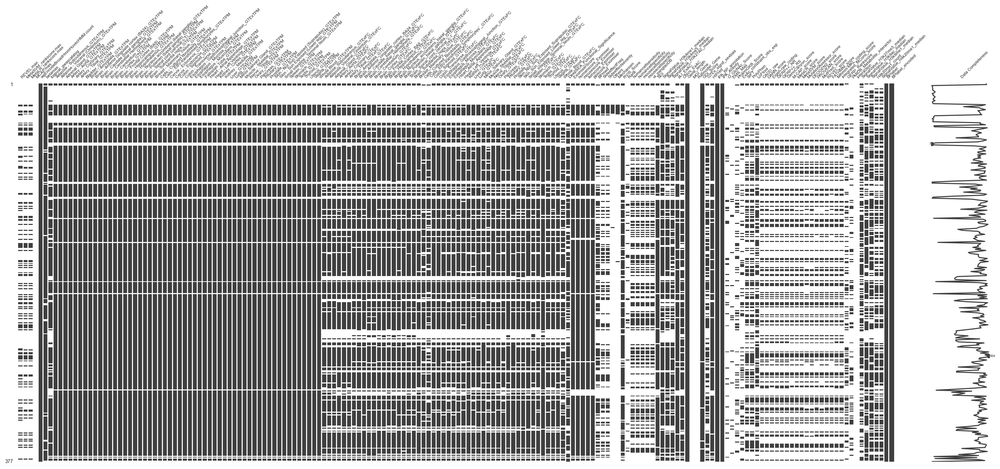

In [6]:
msno.matrix(data, labels=True, fontsize=6)

In [7]:
plt.rcParams["legend.title_fontsize"] = "large"
fig = msno.heatmap(data, figsize=(75, 75))
fig_copy = fig.get_figure()
fig_copy.savefig("missing_corr.png", format="png", dpi=300, bbox_inches="tight")

In [8]:
data.isnull().sum()

REVEL.max                         271
MetaSVM_rankscore.max             280
MetaLR_rankscore.max              280
MCAP.max                          377
wgEncodeBroadHmmHuvecHMM.count      0
                                 ... 
SignalValue_H3k9me1_median        127
H4k20me1_count                    168
SignalValue_H4k20me1_median       168
BPlabel                             0
BPlabel_encoded                     0
Length: 176, dtype: int64

In [9]:
natest = data.isnull().sum()
natest.sort_values(inplace=True)

In [10]:
percent_missing = data.isnull().sum() * 100 / len(data)
missing_value_df = pd.DataFrame(
    {"column_name": data.columns, "percent_missing": percent_missing}
)
missing_value_df.sort_values("percent_missing", inplace=True)

In [11]:
natest = natest.to_frame()
missingdata = natest.join(missing_value_df)

In [12]:
missingdata.to_csv("traininggenes_features_with_NA.csv")

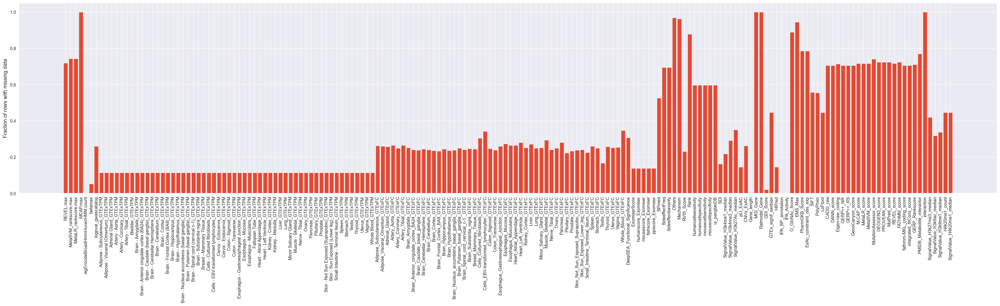

In [13]:
data_drop = data.drop(["BPlabel", "BPlabel_encoded",], 1)

null_counts = data_drop.isnull().sum() / len(data_drop)
plt.figure(figsize=(40, 8))
plt.xticks(np.arange(len(null_counts)) + 0.0, null_counts.index, rotation="vertical")
plt.ylabel("Fraction of rows with missing data")
plt.bar(np.arange(len(null_counts)), null_counts)
plt.savefig("missingness.png", format="png", dpi=300, bbox_inches="tight")

In [14]:
selection = missing_value_df[missing_value_df["percent_missing"] < 25.00]
list(selection["column_name"])

['BPlabel_encoded',
 'IPA_Activity',
 'IPA_BP_annotation',
 'BPlabel',
 'wgEncodeBroadHmmHuvecHMM.count',
 'Gene_length',
 'GDI_Score',
 'betamax',
 'Muscle - Skeletal_GTExTPM',
 'Minor Salivary Gland_GTExTPM',
 'Lung_GTExTPM',
 'Liver_GTExTPM',
 'Kidney - Medulla_GTExTPM',
 'Fallopian Tube_GTExTPM',
 'Heart - Left Ventricle_GTExTPM',
 'Heart - Atrial Appendage_GTExTPM',
 'Nerve - Tibial_GTExTPM',
 'Esophagus - Muscularis_GTExTPM',
 'Kidney - Cortex_GTExTPM',
 'Ovary_GTExTPM',
 'Skin - Not Sun Exposed (Suprapubic)_GTExTPM',
 'Pituitary_GTExTPM',
 'Prostate_GTExTPM',
 'Esophagus - Mucosa_GTExTPM',
 'Skin - Sun Exposed (Lower leg)_GTExTPM',
 'Small Intestine - Terminal Ileum_GTExTPM',
 'Spleen_GTExTPM',
 'Testis_GTExTPM',
 'Thyroid_GTExTPM',
 'Uterus_GTExTPM',
 'Vagina_GTExTPM',
 'Whole Blood_GTExTPM',
 'Pancreas_GTExTPM',
 'Esophagus - Gastroesophageal Junction_GTExTPM',
 'Stomach_GTExTPM',
 'Colon - Sigmoid_GTExTPM',
 'Adipose - Visceral (Omentum)_GTExTPM',
 'Adrenal Gland_GTExTPM',
 '

## Feature Correlation:

In [15]:
dat = data[list(selection["column_name"])]
dat["Gene"] = dataset["Gene"]

dt2 = dat
dat = dat.set_index("Gene")

df = dt2
df = df.set_index("Gene")
df["BPlabel_encoded"] = df["BPlabel"].map(
    {"most likely": 1, "probable": 0.75,"possible":0.5, "least likely": 0.1}
)

# removing remaining variant-level features strongly correlating with gene length:
df = df.drop(
    [
        "BPlabel",
        "Gene_length",
        "CADD_RAW",
        "gwastrait",
        "HIPred",
        "ppiscore_Exomiser",
        "DNaseCluster_count",
        "H3k4me1_count",
        "CpGcount",
        "EnhancerCount",
        "H3k4me3_count",
        "H3k27Ac_count",
    ],
    1,
    errors="ignore",
)
df.shape

(377, 94)

In [16]:
X = MinMaxScaler().fit_transform(df)
imputer = MissForest(random_state=seed)
X = pd.DataFrame(imputer.fit_transform(X), index=df.index, columns=df.columns)

Iteration: 0
Iteration: 1
Iteration: 2
Iteration: 3
Iteration: 4
Iteration: 5
Iteration: 6


BPlabel_encoded        1.000000
BPmed                  0.815985
Mechanism              0.616164
HIPred                 0.423380
ExomiserScore          0.397283
                         ...   
fishscore_Exomiser          NaN
MGI_Gene                    NaN
Ratmodel_Gene               NaN
GTEx_signif_sexbias         NaN
interaction                 NaN
Name: BPlabel_encoded, Length: 174, dtype: float64


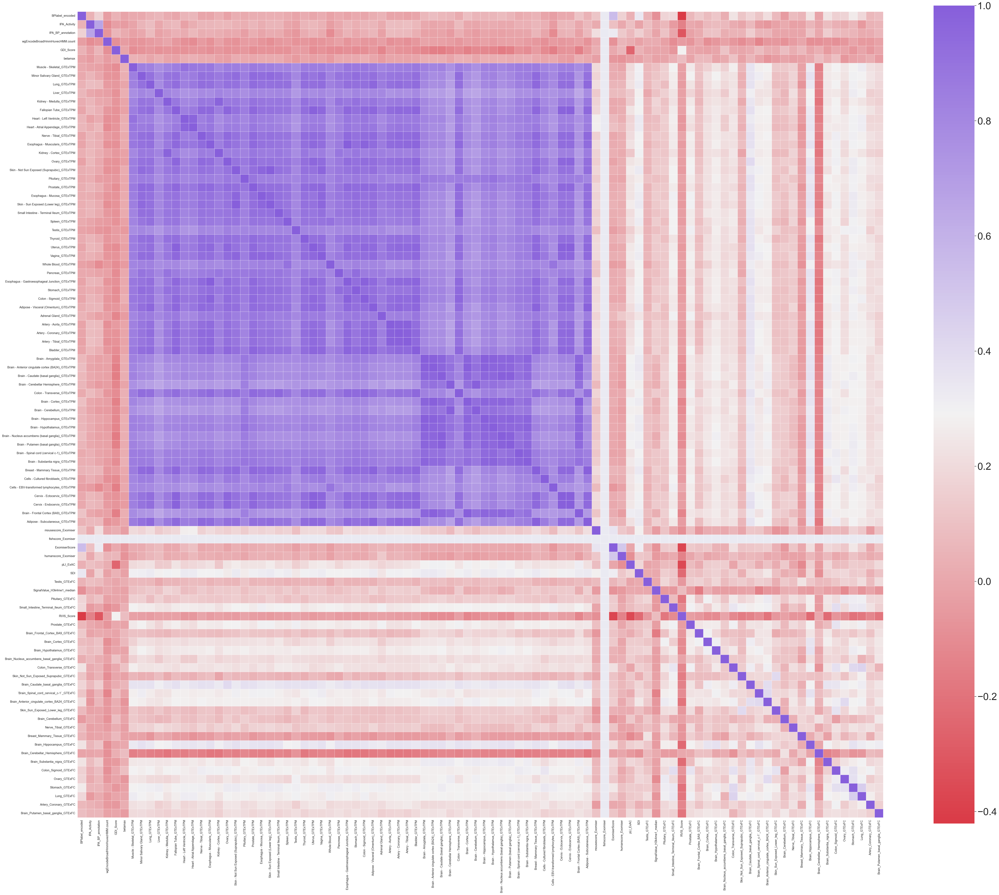

In [17]:
Xcor = X

Xcor = pd.DataFrame(data=Xcor, columns=X.columns)

corr = Xcor.corr(method="spearman")

f, ax = plt.subplots(figsize=(60, 50))

cmap = sns.diverging_palette(10, 275, as_cmap=True)
sns.set(font_scale=3)

htmap = sns.heatmap(
    corr,
    cmap=cmap,
    square=True,
    xticklabels=True,
    yticklabels=True,
    linewidths=0.5,
    ax=ax,
)

figure = htmap.get_figure()
figure.savefig("correlation_heatmap.png", format="png", dpi=300, bbox_inches="tight")

corr_matrix = data.corr()
print(corr_matrix["BPlabel_encoded"].sort_values(ascending=False))
corr = corr_matrix["BPlabel_encoded"].sort_values(ascending=False)

In [18]:
def corrFilter(x: pd.DataFrame, bound: float):
    xCorr = x.corr()
    xFiltered = xCorr[((xCorr >= bound) | (xCorr <= -bound)) & (xCorr != 1.000)]
    xFlattened = xFiltered.unstack().sort_values().drop_duplicates()
    return xFlattened


corrFilter(X, 0.9)

pairs = corrFilter(X, 0.9)
pairs.to_csv("corr_pairs.csv", header=True)

In [19]:
corr_matrix.to_csv("corr_matrix.csv", header=True)

In [20]:
corr.to_csv("training_correlation.csv", header=True)

In [21]:
corr = X.corr()
corr.head()

,BPlabel_encoded,IPA_Activity,IPA_BP_annotation,wgEncodeBroadHmmHuvecHMM.count,GDI_Score,betamax,Muscle - Skeletal_GTExTPM,Minor Salivary Gland_GTExTPM,Lung_GTExTPM,Liver_GTExTPM,...,Breast_Mammary_Tissue_GTExFC,Brain_Hippocampus_GTExFC,Brain_Cerebellar_Hemisphere_GTExFC,Brain_Substantia_nigra_GTExFC,Colon_Sigmoid_GTExFC,Ovary_GTExFC,Stomach_GTExFC,Lung_GTExFC,Artery_Coronary_GTExFC,Brain_Putamen_basal_ganglia_GTExFC
BPlabel_encoded,1.000000,0.105441,0.268387,0.014782,-0.010818,-0.006611,0.015868,0.036731,0.053750,0.092074,...,0.030492,0.213700,-0.040397,0.145064,0.157918,0.208535,0.229755,0.273774,-0.007491,0.084268
IPA_Activity,0.105441,1.000000,0.621480,-0.031848,-0.018313,-0.060757,-0.034527,0.036473,-0.002775,0.058490,...,-0.065715,0.065365,-0.064587,0.041163,0.082870,0.038903,0.075025,-0.035394,0.042249,-0.028264
IPA_BP_annotation,0.268387,0.621480,1.000000,-0.032211,0.007267,0.015363,-0.068822,-0.012387,-0.000550,0.090239,...,-0.001931,0.097180,-0.062869,0.036375,0.108738,0.090525,0.063314,0.070485,-0.054994,-0.017795
wgEncodeBroadHmmHuvecHMM.count,0.014782,-0.031848,-0.032211,1.000000,0.057767,0.000791,-0.003846,-0.034991,-0.032316,-0.028804,...,0.023073,-0.027298,-0.021015,-0.000920,-0.035923,-0.018852,0.009498,-0.011835,-0.000515,-0.014033
GDI_Score,-0.010818,-0.018313,0.007267,0.057767,1.000000,0.006503,-0.007600,0.256892,0.323000,0.051459,...,0.001490,-0.020566,0.025118,0.015666,0.010214,0.002026,-0.058640,-0.009024,-0.017343,-0.009961


In [22]:
Xcor = X
Xcor = pd.DataFrame(data=Xcor, columns=X.columns)
corr = Xcor.corr(method="spearman").abs()
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]
print("Dropped features with > 0.9 correlation:", to_drop)
len(to_drop)

Dropped features with > 0.9 correlation: ['Lung_GTExTPM', 'Fallopian Tube_GTExTPM', 'Heart - Left Ventricle_GTExTPM', 'Heart - Atrial Appendage_GTExTPM', 'Nerve - Tibial_GTExTPM', 'Esophagus - Muscularis_GTExTPM', 'Kidney - Cortex_GTExTPM', 'Ovary_GTExTPM', 'Skin - Not Sun Exposed (Suprapubic)_GTExTPM', 'Prostate_GTExTPM', 'Esophagus - Mucosa_GTExTPM', 'Skin - Sun Exposed (Lower leg)_GTExTPM', 'Small Intestine - Terminal Ileum_GTExTPM', 'Spleen_GTExTPM', 'Thyroid_GTExTPM', 'Uterus_GTExTPM', 'Vagina_GTExTPM', 'Whole Blood_GTExTPM', 'Esophagus - Gastroesophageal Junction_GTExTPM', 'Stomach_GTExTPM', 'Colon - Sigmoid_GTExTPM', 'Adipose - Visceral (Omentum)_GTExTPM', 'Artery - Aorta_GTExTPM', 'Artery - Coronary_GTExTPM', 'Artery - Tibial_GTExTPM', 'Bladder_GTExTPM', 'Brain - Anterior cingulate cortex (BA24)_GTExTPM', 'Brain - Caudate (basal ganglia)_GTExTPM', 'Brain - Cerebellar Hemisphere_GTExTPM', 'Colon - Transverse_GTExTPM', 'Brain - Cortex_GTExTPM', 'Brain - Cerebellum_GTExTPM', 'Brai

43

In [23]:
selected_columns = X.drop(X[to_drop], axis=1)
list(selected_columns)

['BPlabel_encoded',
 'IPA_Activity',
 'IPA_BP_annotation',
 'wgEncodeBroadHmmHuvecHMM.count',
 'GDI_Score',
 'betamax',
 'Muscle - Skeletal_GTExTPM',
 'Minor Salivary Gland_GTExTPM',
 'Liver_GTExTPM',
 'Kidney - Medulla_GTExTPM',
 'Pituitary_GTExTPM',
 'Testis_GTExTPM',
 'Pancreas_GTExTPM',
 'Adrenal Gland_GTExTPM',
 'Brain - Amygdala_GTExTPM',
 'Cells - Cultured fibroblasts_GTExTPM',
 'Cells - EBV-transformed lymphocytes_GTExTPM',
 'mousescore_Exomiser',
 'fishscore_Exomiser',
 'ExomiserScore',
 'humanscore_Exomiser',
 'pLI_ExAC',
 'SDI',
 'Testis_GTExFC',
 'SignalValue_H3k4me1_median',
 'Pituitary_GTExFC',
 'Small_Intestine_Terminal_Ileum_GTExFC',
 'RVIS_Score',
 'Prostate_GTExFC',
 'Brain_Frontal_Cortex_BA9_GTExFC',
 'Brain_Cortex_GTExFC',
 'Brain_Hypothalamus_GTExFC',
 'Brain_Nucleus_accumbens_basal_ganglia_GTExFC',
 'Colon_Transverse_GTExFC',
 'Skin_Not_Sun_Exposed_Suprapubic_GTExFC',
 'Brain_Caudate_basal_ganglia_GTExFC',
 '`Brain_Spinal_cord_cervical_c-1`_GTExFC',
 'Brain_Anteri

### Viewing genes >25% missing rowwise for selected features (after running BorutaShap)

In [24]:
dt = dat[
    [
       'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]

In [25]:
dt["missing_count"] = dt.isnull().sum(axis=1)

dt["missing_percentage"] = (dt["missing_count"] / 19) * 100

dt.sort_values("missing_percentage", inplace=True)
print(dt[["missing_count", "missing_percentage"]])
# dt.shape

            missing_count  missing_percentage
Gene                                         
ABCC8                   0            0.000000
NEDD4L                  0            0.000000
NDUFS3                  0            0.000000
NDUFA2                  0            0.000000
MYO9B                   0            0.000000
...                   ...                 ...
AC111200.1              8           42.105263
AC108868.1              8           42.105263
AC093677.1              8           42.105263
AL160274.1              8           42.105263
ZSCAN5D                 8           42.105263

[377 rows x 2 columns]


In [26]:
dtmissing = dt.loc[dt["missing_percentage"] > 25]
dtmissing

,Brain_Anterior_cingulate_cortex_BA24_GTExFC,Breast_Mammary_Tissue_GTExFC,HIPred,mousescore_Exomiser,SDI,RVIS_Score,Colon_Transverse_GTExFC,Brain_Cortex_GTExFC,missing_count,missing_percentage
Gene,,,,,,,,,,
KRTAP6-3,NaN,NaN,0.123297,0.0,1.987175,NaN,NaN,NaN,5,26.315789
TBC1D3G,NaN,NaN,0.186892,0.0,0.000000,NaN,NaN,NaN,5,26.315789
PRAMEF1,NaN,NaN,0.255355,0.0,NaN,1.67,NaN,NaN,5,26.315789
PRAMEF12,NaN,NaN,0.111908,0.0,NaN,1.16,NaN,NaN,5,26.315789
PKD1L3,NaN,-6.643856,NaN,NaN,5.953458,NaN,-0.972934,NaN,5,26.315789
OR2AJ1,NaN,NaN,0.123297,0.0,0.000000,NaN,NaN,NaN,5,26.315789
KRTAP9-7,NaN,NaN,0.111908,0.0,1.988414,NaN,NaN,NaN,5,26.315789
OR1D5,NaN,NaN,0.255355,0.0,0.000000,NaN,NaN,NaN,5,26.315789
MTRNR2L5,NaN,NaN,NaN,0.0,1.999325,NaN,NaN,NaN,6,31.578947


### Gene length distribution:


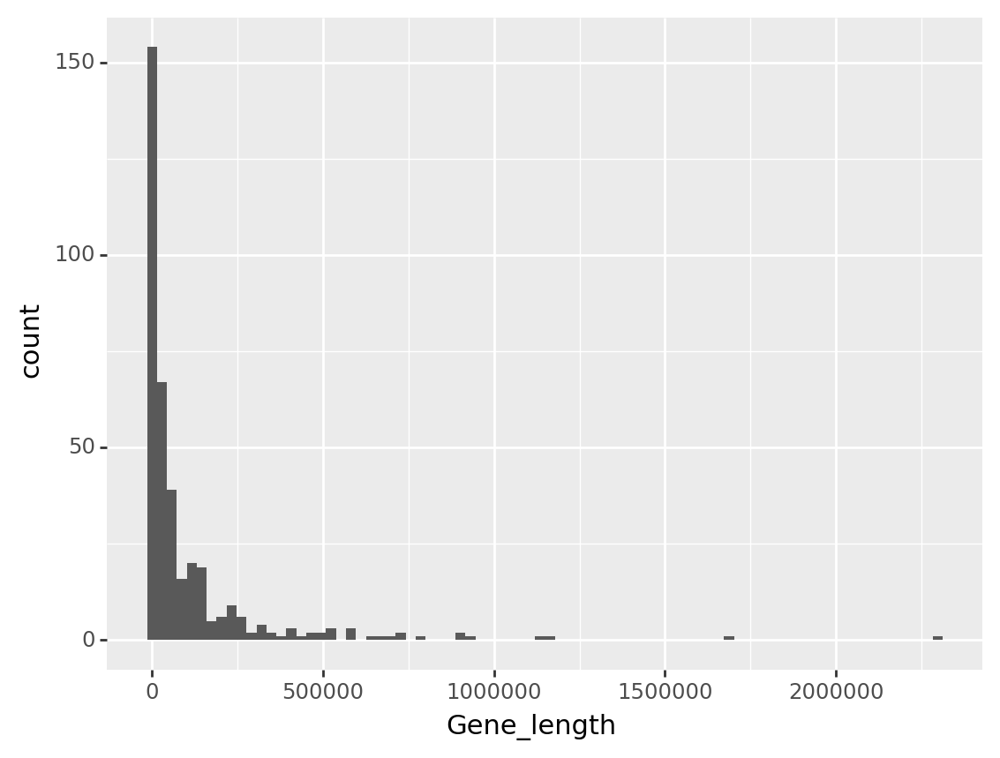

<ggplot: (8787982560725)>

In [27]:
(ggplot(dat, aes(x="Gene_length")) + geom_histogram())

In [28]:
dt_ml = data.loc[data["BPlabel_encoded"] == 1.0]

dt_ml = dt_ml[
    [
      'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]


dt_ll = data.loc[data["BPlabel_encoded"] == 0.1]

dt_ll = dt_ll[
    [
       'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]

target_0 = data.loc[data["BPlabel_encoded"] == 0.1]
target_1 = data.loc[data["BPlabel_encoded"] == 1]
target_2 = data.loc[data["BPlabel_encoded"] == 0.75]
combo = pd.concat([target_0, target_1])
combo2 = pd.concat([target_0, target_1, target_2])

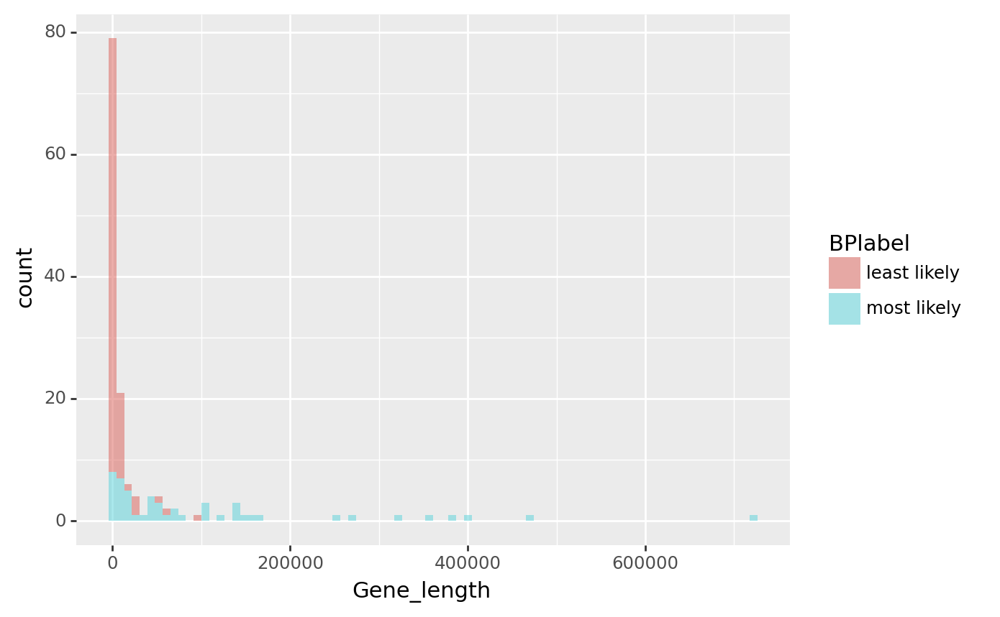

<ggplot: (8787931564345)>

In [29]:
(ggplot(combo, aes(x="Gene_length", fill="BPlabel")) + geom_histogram(alpha=0.5))

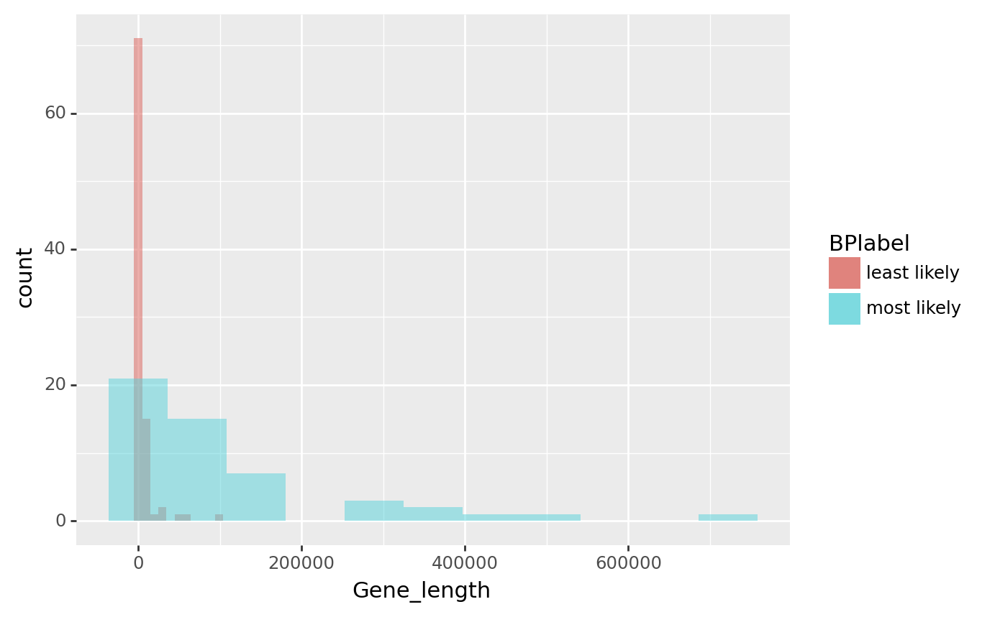

<ggplot: (8787931564600)>

In [30]:
(
    ggplot()
    + geom_histogram(target_0, aes(x="Gene_length", fill="BPlabel"), alpha=0.5)
    + geom_histogram(target_1, aes(x="Gene_length", fill="BPlabel"), alpha=0.5)
)

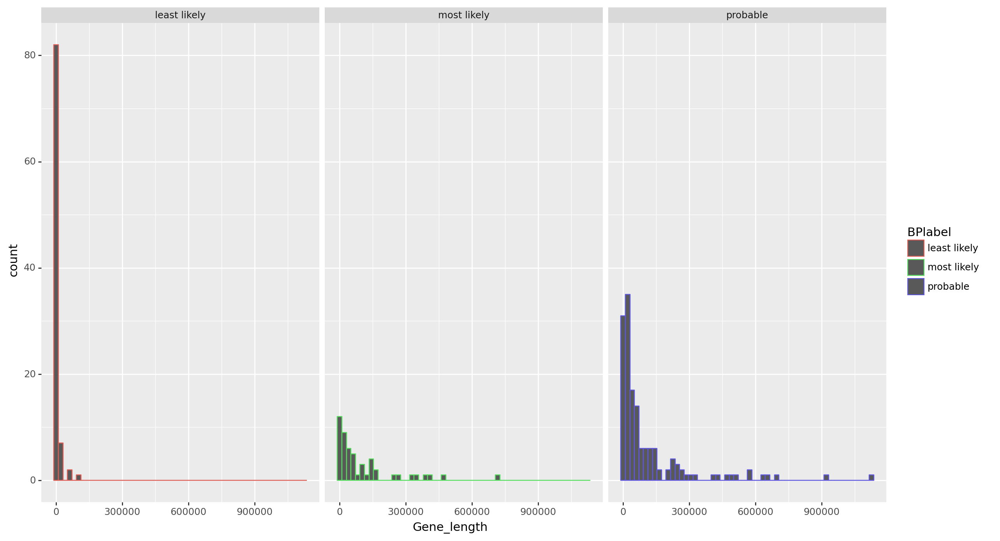

<ggplot: (8787932184625)>

In [31]:
ggplot(combo2, aes(x="Gene_length", color="BPlabel")) + geom_histogram() + facet_wrap(
    ["BPlabel"]
) + theme(figure_size=(14, 8))

### Feature distribution:

In [32]:
def draw_histograms(dataf, variables, n_rows, n_cols):
    fig = plt.figure()
    for i, var_name in enumerate(variables):
        ax = fig.add_subplot(n_rows, n_cols, i + 1)
        df[var_name].hist(
            bins=40,
            linewidth=1.0,
            xlabelsize=18,
            ylabelsize=18,
            figsize=(30, 30),
            ax=ax,
        )
        ax.set_title(var_name + " Distribution")
    fig.tight_layout()
    plt.suptitle("Training Data Univariate Plots", y=1.02, fontsize=35)
    plt.savefig(
        "training_gene_feature_distribution.png", format="png", dpi=300, bbox_inches="tight"
    )
    plt.show()


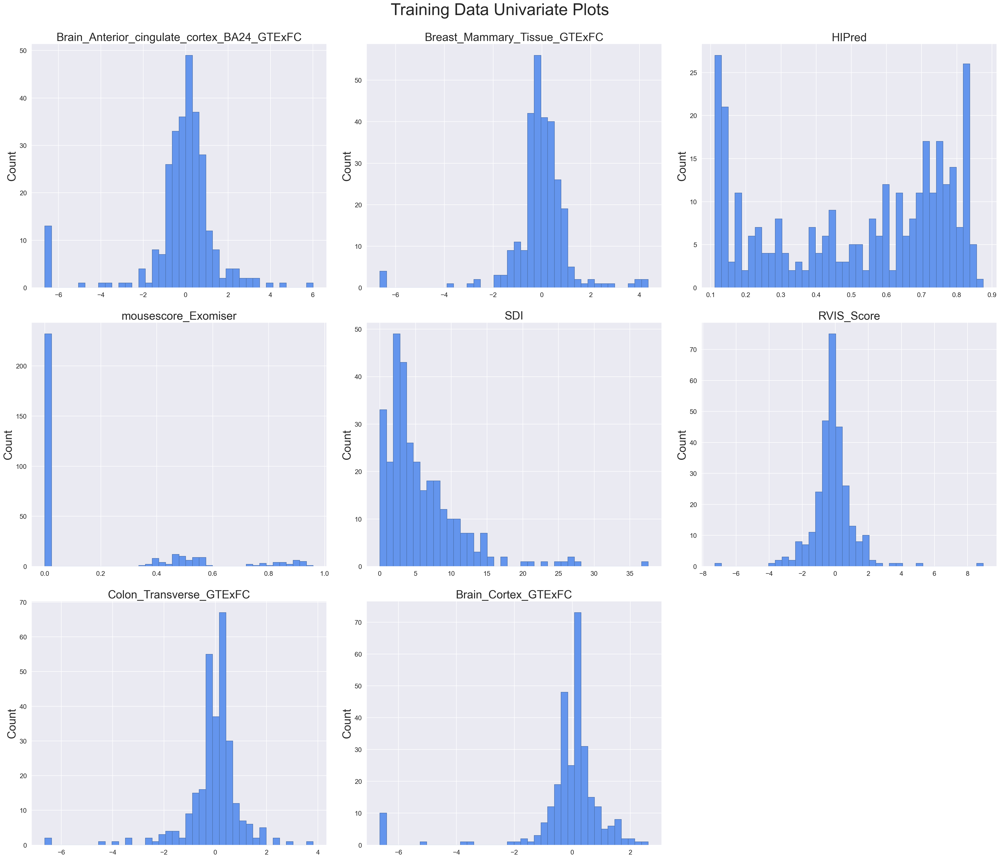

In [33]:
# features only selected by BorutaShap:
sns.set(font_scale=2)
features_list = [
      'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
]


axarr = dt[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    # grid=False,
    figsize=(30, 25),
    color="cornflowerblue",
)

for ax in axarr.flatten():
    ax.set_ylabel("Count")

plt.tight_layout()
plt.grid(axis="x", color="0.95")
plt.suptitle("Training Data Univariate Plots", y=1.02, fontsize=35)

plt.savefig(
    "Training_gene_feature_distribution.png", format="png", dpi=300, bbox_inches="tight"
)

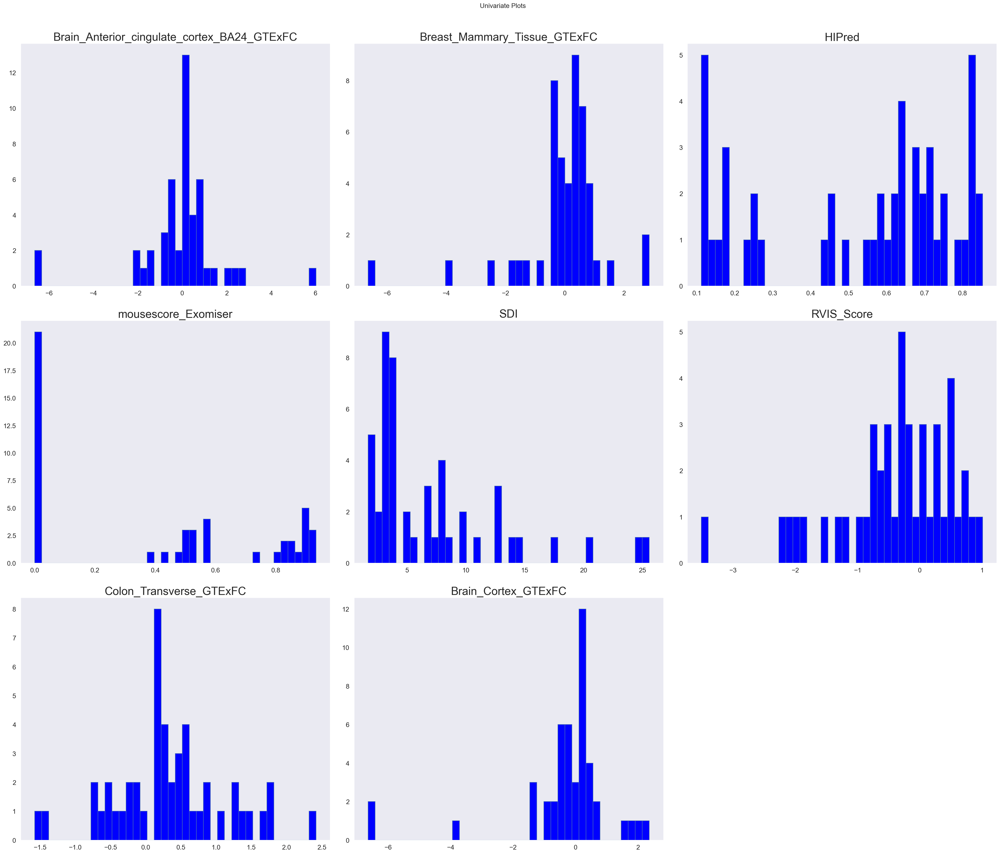

In [34]:
# most likely genes

dt_ml = data.loc[data["BPlabel_encoded"] == 1.0]

dt_ml = dt_ml[
    [
       'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]

sns.set(font_scale=2)
features_list = list(dt_ml.columns)

dt_ml[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

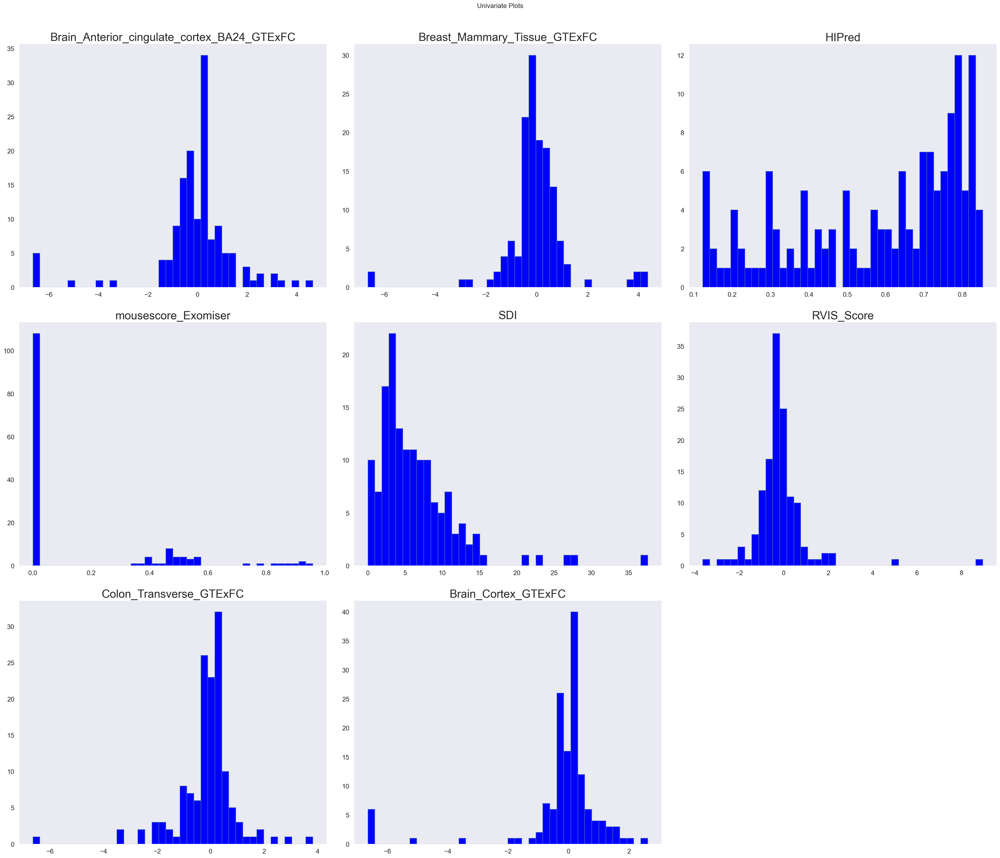

In [35]:
# probable genes

dt_p = data.loc[data["BPlabel_encoded"] == 0.75]

dt_p = dt_p[
    [
        'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]


sns.set(font_scale=2)
features_list = list(dt_p.columns)

dt_p[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

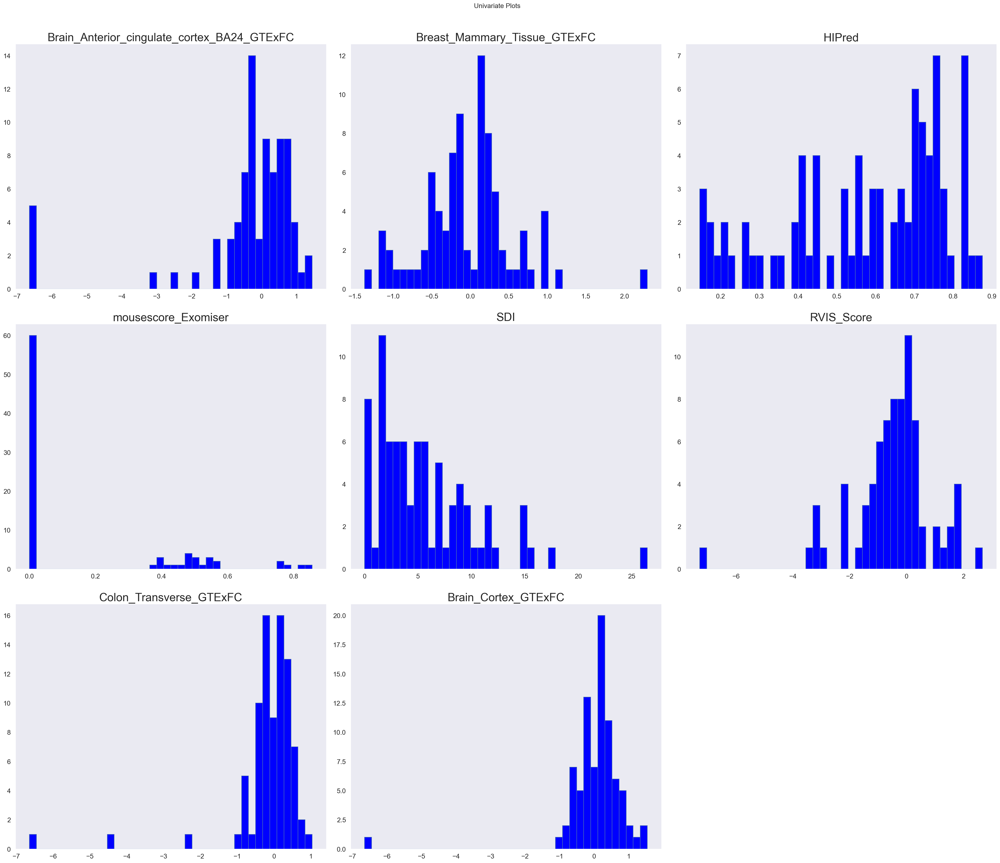

In [36]:
# possible genes

dt_p = data.loc[data["BPlabel_encoded"] == 0.5]

dt_p = dt_p[
    [
        'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]


sns.set(font_scale=2)
features_list = list(dt_p.columns)

dt_p[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

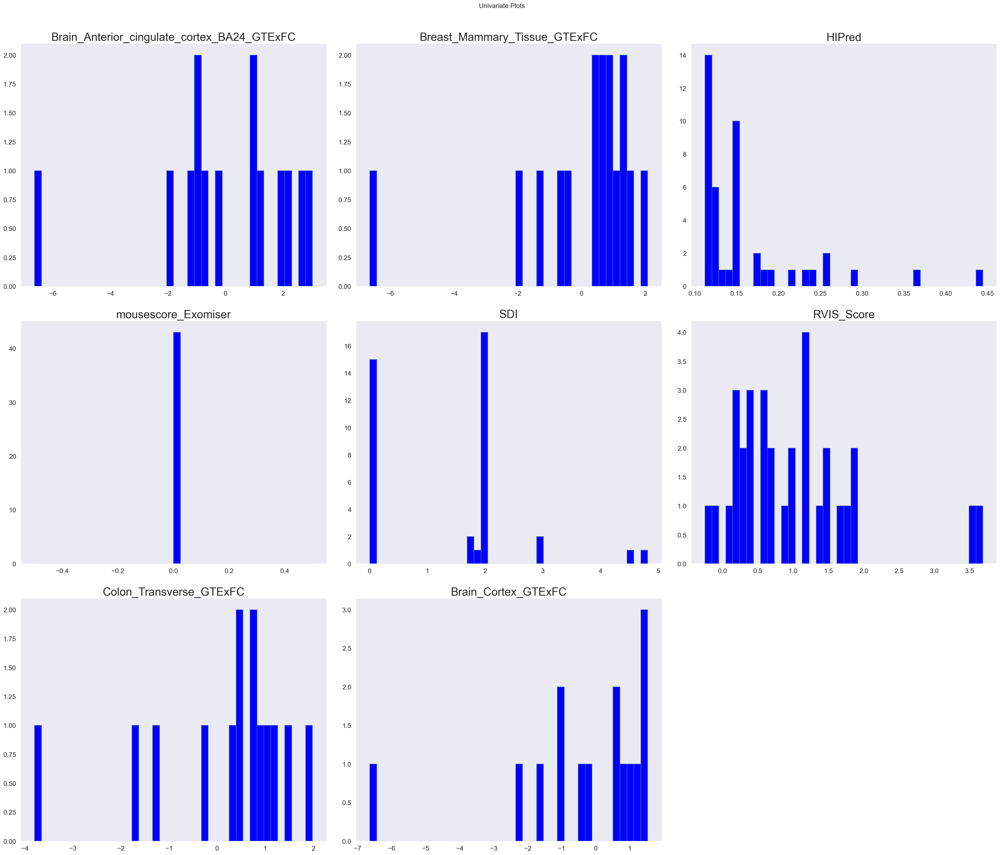

In [37]:
# least likely genes
dt_ll = data.loc[data["BPlabel_encoded"] == 0.1]

dt_ll = dt_ll[
    [
      'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]

sns.set(font_scale=2)
features_list = list(dt_ll.columns)

dt_ll[features_list].hist(
    bins=40,
    edgecolor="b",
    linewidth=1.0,
    xlabelsize=14,
    ylabelsize=14,
    grid=False,
    figsize=(30, 25),
    color="blue",
)
plt.tight_layout()
ax.set_ylabel("Gene Count")

plt.suptitle("Univariate Plots", y=1.02, fontsize=14);

### Covariation Heatmaps:

Text(0.5, 1.0, 'Covariance between different features')

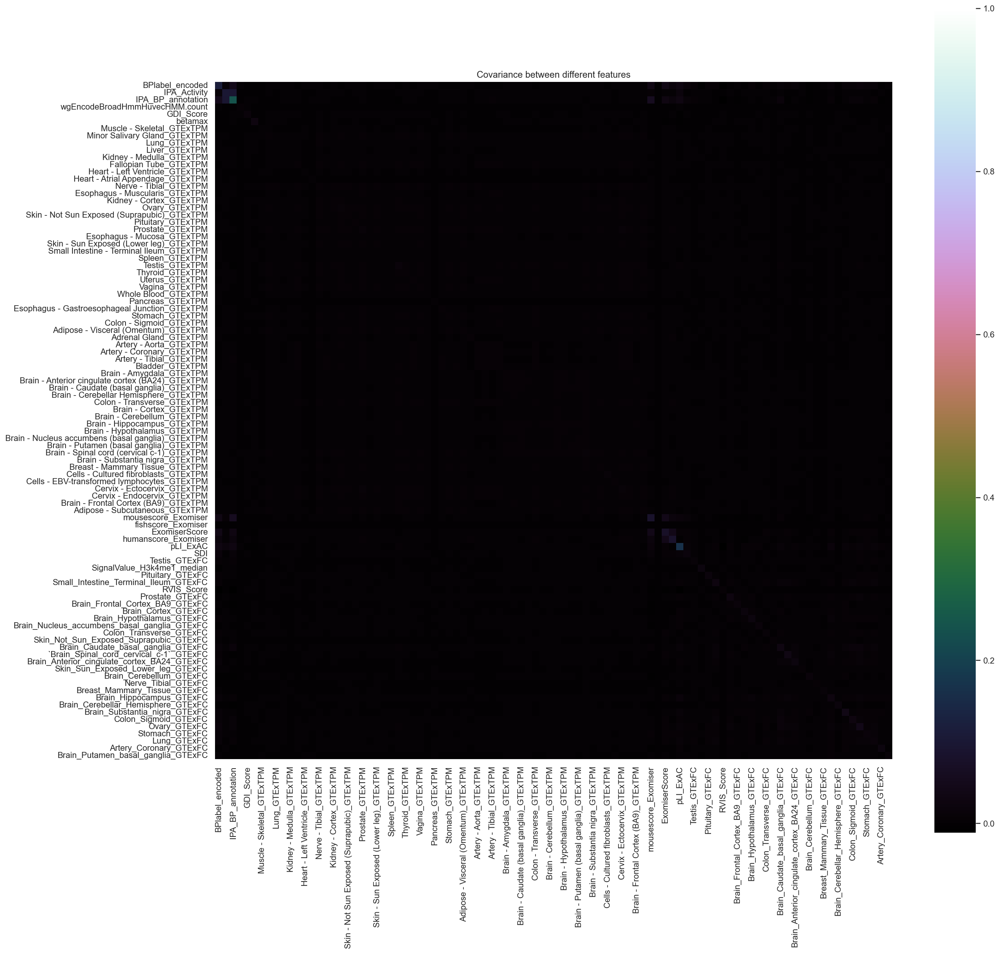

In [38]:
mean_vec = np.mean(Xcor, axis=0)
cov_mat = (Xcor - mean_vec).T.dot((Xcor - mean_vec)) / (Xcor.shape[0] - 1)
# print('Covariance matrix \n%s' %cov_mat)
sns.set(font_scale=1)
plt.figure(figsize=(20, 20))
sns.heatmap(cov_mat, vmax=1, square=True, cmap="cubehelix")

plt.title("Covariance between different features")

## Visualization of Selected Features
Features selected by BorutaShap

In [39]:
X2 = pd.read_csv("imputed_training_data.csv", header=0)
X2 = pd.concat([X2, Y], axis=1)

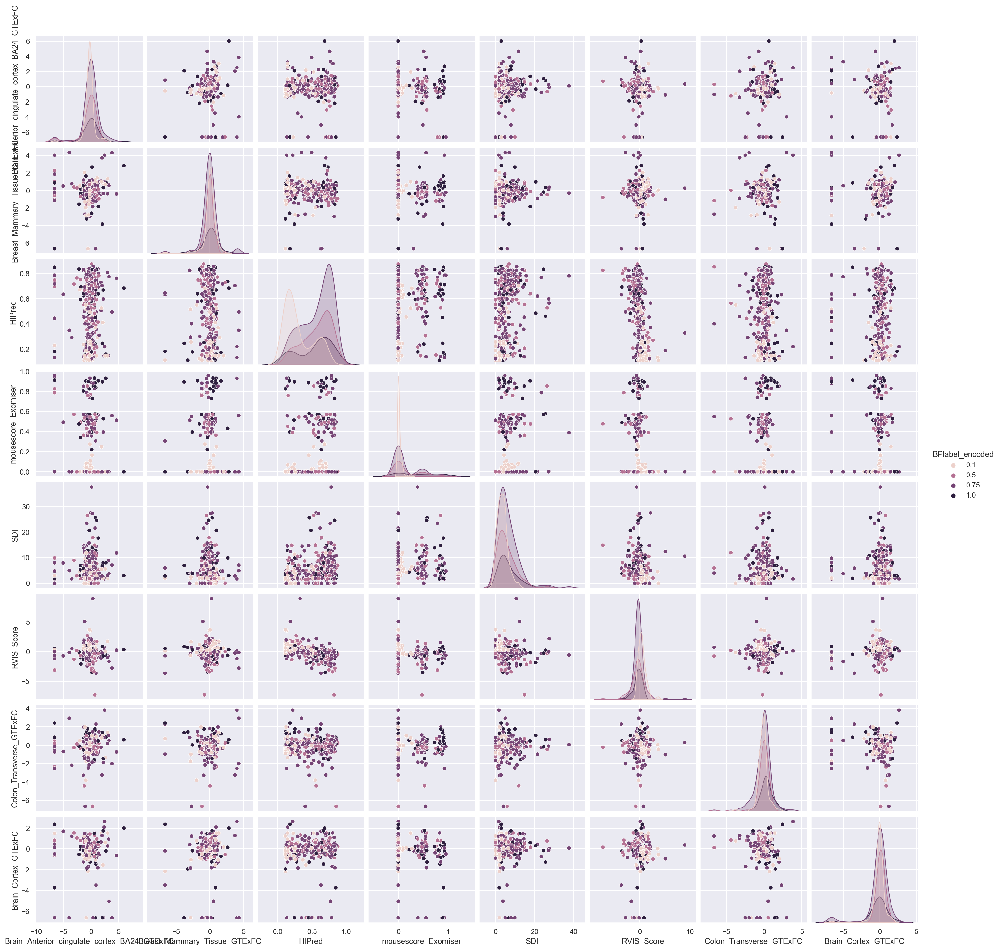

In [40]:
sns.set(font_scale=1)
Xplot = X2
sns.pairplot(
    Xplot,
    hue="BPlabel_encoded",
    vars=[
      'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ],
)

## Mutual Information of Selected Features
Mutual information (MI) between two random variables is a non-negative value, which measures the dependency between the variables. It is equal to zero if and only if two random variables are independent, and higher values mean higher dependency.

In [41]:
X2 = X2[
    [
       'Brain_Anterior_cingulate_cortex_BA24_GTExFC', 'Breast_Mammary_Tissue_GTExFC', 'HIPred', 'mousescore_Exomiser', 'SDI', 'RVIS_Score', 'Colon_Transverse_GTExFC', 'Brain_Cortex_GTExFC'
    ]
]

## Comparison of F-test and mutual information
As F-test captures only linear dependency, it rates x_1 (HIPred) as the most discriminative feature. On the other hand, mutual information can capture any kind of dependency between variables and it rates x_4 (HIPred) as the most discriminative feature, which probably agrees better with our intuitive perception for this example. Both methods mark GTEx tissues (x_5 - x_7) as having the least relevance.

Mutual Information:
It measures the average reduction in uncertainty about x that results from learning the value of y; or vice versa, the average amount of information that x conveys about y — Page 139, Information Theory, Inference, and Learning Algorithms, 2003.


F-Test: calculates F-statistic and does a hypothesis testing model X and Y where X is a model created by just a constant and Y is the model created by a constant and a feature.

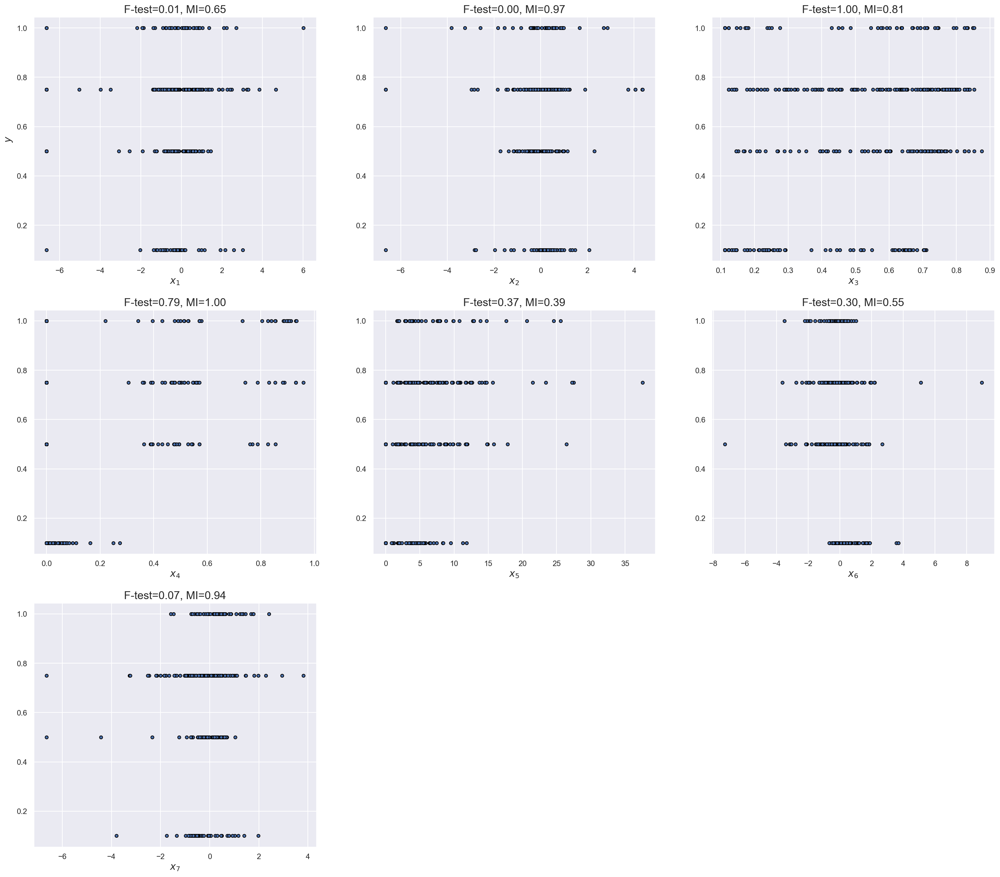

In [42]:
f_test, _ = f_regression(X2, Y)
f_test /= np.max(f_test)

mi = mutual_info_regression(X2, Y)
mi /= np.max(mi)

plt.figure(figsize=(25, 30))
for i in range(7):
    plt.subplot(4, 3, i + 1)
    plt.scatter(X2.iloc[:, i], Y, edgecolor="black", s=20)
    plt.xlabel("$x_{}$".format(i + 1), fontsize=14)
    if i == 0:
        plt.ylabel("$y$", fontsize=14)
    plt.title("F-test={:.2f}, MI={:.2f}".format(f_test[i], mi[i]), fontsize=16)
plt.show()

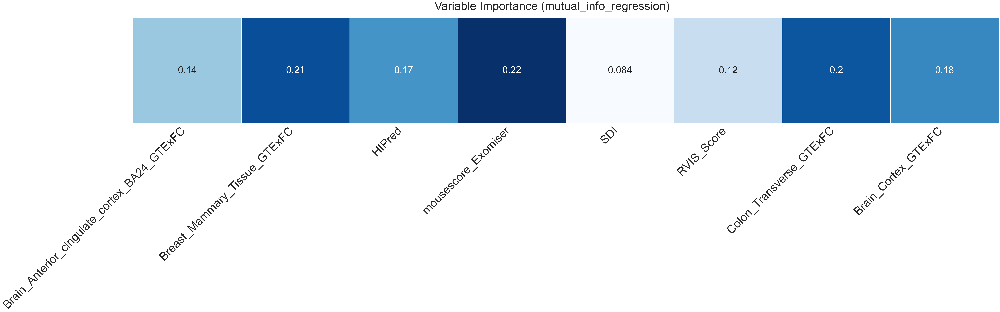

In [43]:
mutual_information = mutual_info_regression(X2, Y)

plt.subplots(1, figsize=(80, 10))
sns.heatmap(
    mutual_information[:, np.newaxis].T,
    cmap="Blues",
    cbar=False,
    linewidths=1,
    annot=True,
    annot_kws={"fontsize": 50},
)
plt.yticks([], [])
plt.gca().set_xticklabels(X2.columns, rotation=45, ha="right", fontsize=60)
plt.suptitle("Variable Importance (mutual_info_regression)", fontsize=60, y=1)
plt.gcf().subplots_adjust(wspace=0.2)
pass


plt.savefig("Mutual info gain.png", format="png", dpi=300, bbox_inches="tight")

### Selected Features Covariance and Correlation:

Text(0.5, 1.0, 'Covariance between different features')

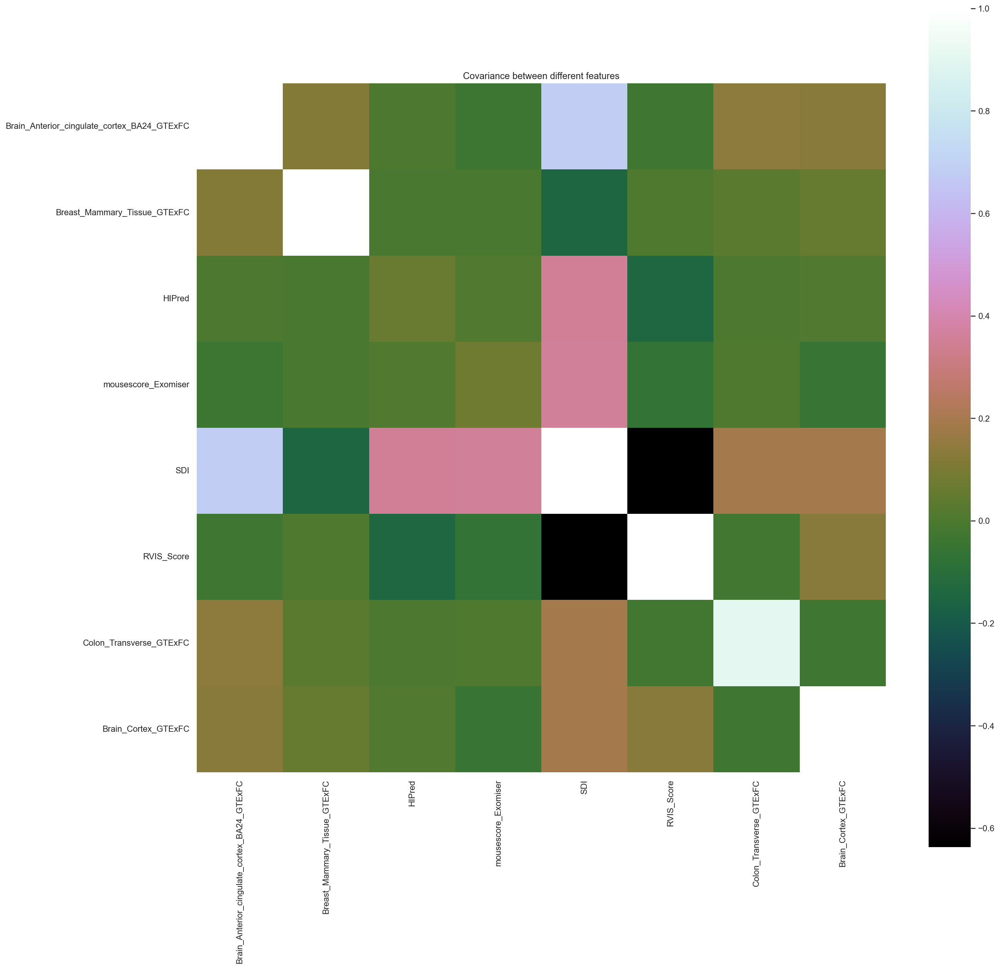

In [44]:
mean_vec = np.mean(X2, axis=0)
cov_mat = (X2 - mean_vec).T.dot((X2 - mean_vec)) / (X2.shape[0] - 1)
# print('Covariance matrix \n%s' %cov_mat)
sns.set(font_scale=1)
plt.figure(figsize=(20, 20))
sns.heatmap(cov_mat, vmax=1, square=True, cmap="cubehelix")

plt.title("Covariance between different features")

In [47]:
Xcor = X2
Xcor = pd.DataFrame(data=Xcor, columns=X2.columns)

corr = Xcor.corr(method="spearman")

f, ax = plt.subplots(figsize=(60, 50))


cmap = sns.diverging_palette(10, 275, as_cmap=True)
sns.set(font_scale=3)
htmap = sns.heatmap(
    corr,
    cmap=cmap,
    square=True,
    xticklabels=True,
    yticklabels=True,
    linewidths=0.5,
    annot_kws={"size":30},
    ax=ax,
)  

figure = htmap.get_figure()
figure.savefig("selected_correlation.png", format="png", dpi=300, bbox_inches="tight")


corr_matrix = data.corr()
print(corr_matrix["BPlabel_encoded"].sort_values(ascending=False))
corr = corr_matrix["BPlabel_encoded"].sort_values(ascending=False)

BPlabel_encoded        1.000000
BPmed                  0.815985
Mechanism              0.616164
HIPred                 0.423380
ExomiserScore          0.397283
                         ...   
fishscore_Exomiser          NaN
MGI_Gene                    NaN
Ratmodel_Gene               NaN
GTEx_signif_sexbias         NaN
interaction                 NaN
Name: BPlabel_encoded, Length: 174, dtype: float64


### Partial Dependence Plots

The y axis is interpreted as change in the prediction from what it would be predicted at the baseline or leftmost value.
A blue shaded area indicates level of confidence

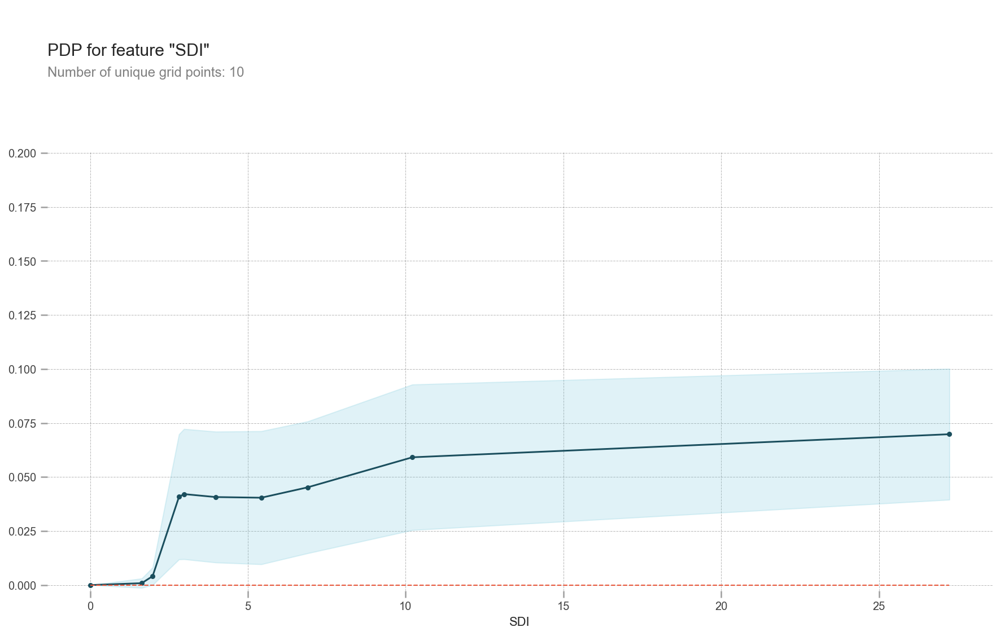

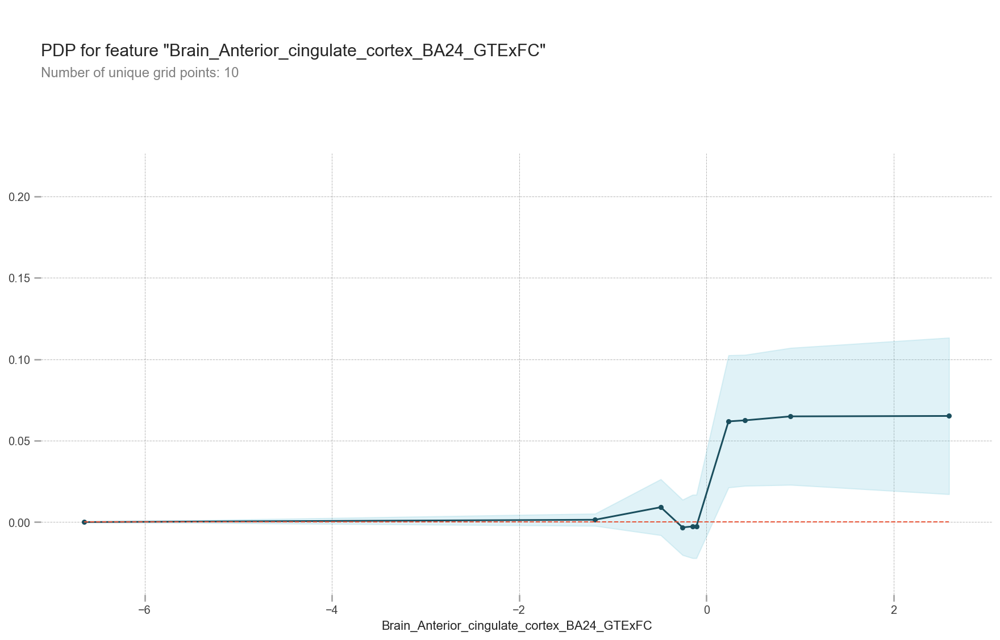

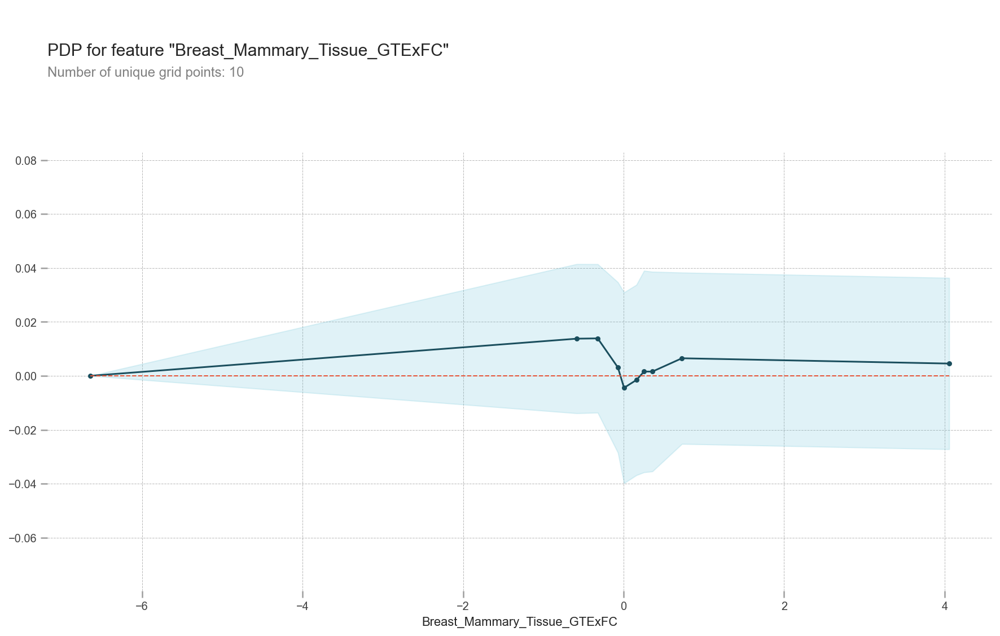

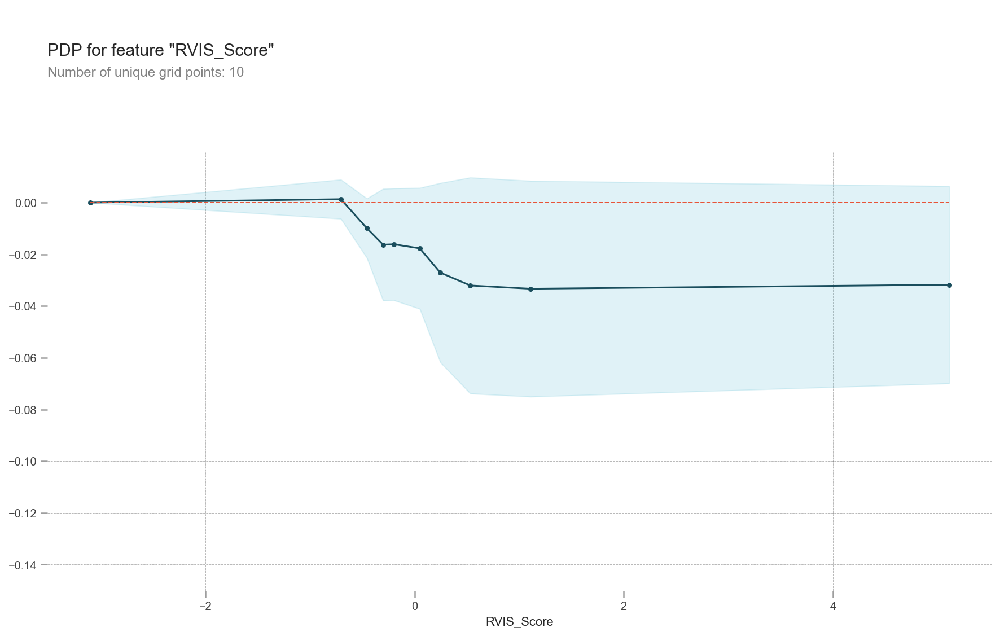

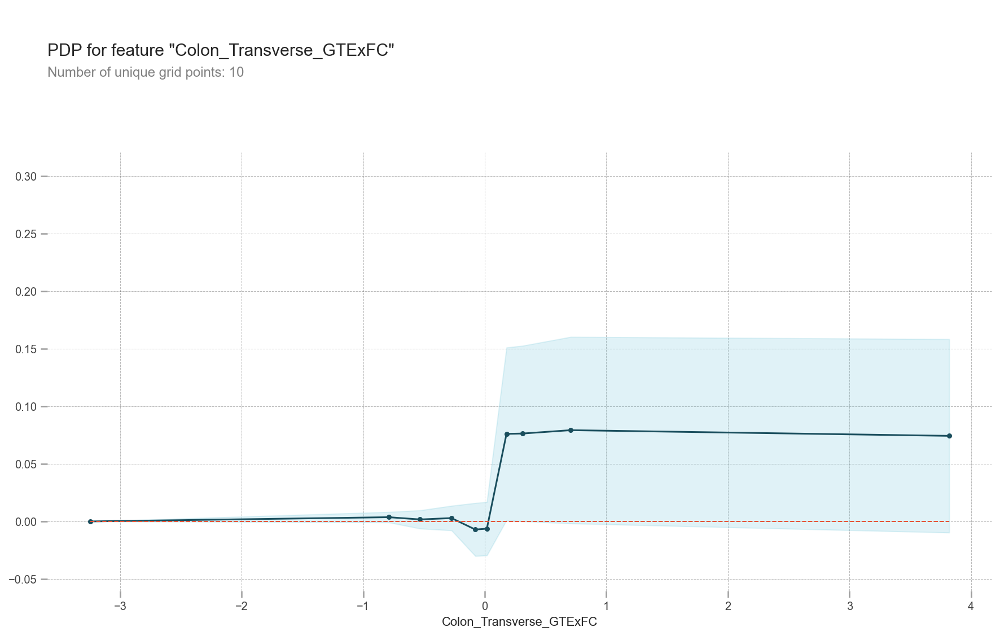

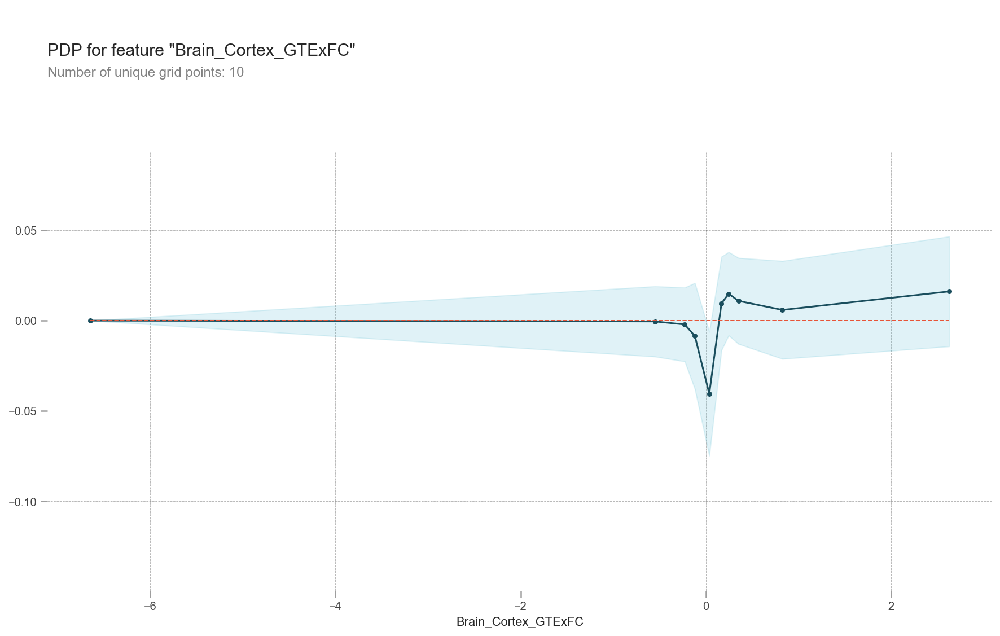

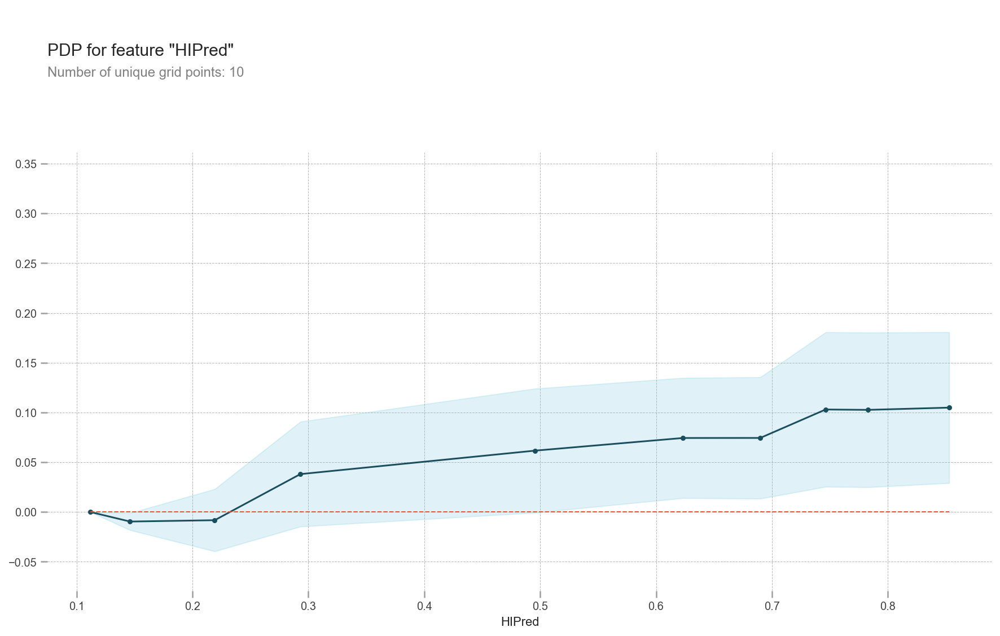

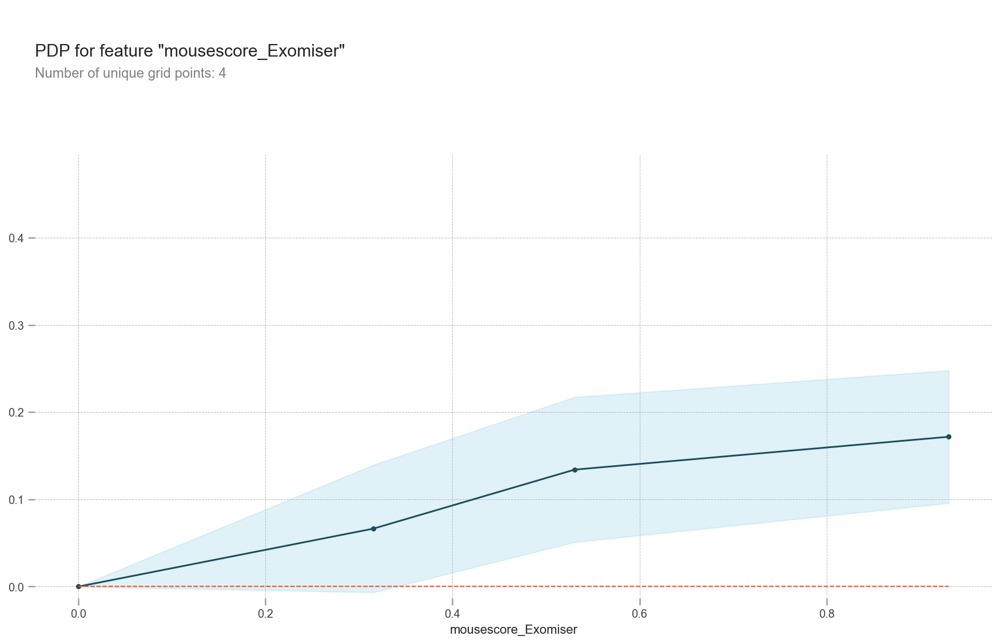

In [48]:
seed = 0
train_X, val_X, train_y, val_y = train_test_split(X2, Y, random_state=1)
tree_model = RandomForestRegressor(
    random_state=seed,
    criterion="mse",
    max_depth=4,
    max_features="sqrt",
    n_estimators=50,
).fit(train_X, train_y)

feature_to_plot = "SDI"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)

pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "Brain_Anterior_cingulate_cortex_BA24_GTExFC"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)

pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "Breast_Mammary_Tissue_GTExFC"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)

pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "RVIS_Score"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)

pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "Colon_Transverse_GTExFC"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)
pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "Brain_Cortex_GTExFC"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)
pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

feature_to_plot = "HIPred"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)
pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()


feature_to_plot = "mousescore_Exomiser"
pdp_dist = pdp.pdp_isolate(
    model=tree_model, dataset=val_X, model_features=X2.columns, feature=feature_to_plot
)

pdp.pdp_plot(pdp_dist, feature_to_plot)
plt.show()

### Clustering to view training data grouping:

#### PCA Explained Variance 
- for deciding n components in hierarchal clustering

In [49]:
mean_vec = np.mean(X2, axis=0)
cov_mat = (X2 - mean_vec).T.dot((X2 - mean_vec)) / (X2.shape[0] - 1)

In [50]:
eig_vals, eig_vecs = np.linalg.eig(cov_mat)

print("Eigenvectors \n%s" % eig_vecs)
print("\nEigenvalues \n%s" % eig_vals)


# Make a list of (eigenvalue, eigenvector) tuples
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:, i]) for i in range(len(eig_vals))]

# Sort the (eigenvalue, eigenvector) tuples from high to low
eig_pairs.sort(key=lambda x: x[0], reverse=True)

# Visually confirm that the list is correctly sorted by decreasing eigenvalues
print("Eigenvalues in descending order:")
for i in eig_pairs:
    print(i[0])

Eigenvectors 
[[-3.12544482e-02  9.79818328e-01  1.41051562e-01 -8.17439179e-02
   8.65142369e-02 -6.74409776e-02  1.90987899e-02  1.95719709e-03]
 [ 6.14070482e-03  1.05058444e-01 -7.57922942e-02 -7.43484503e-02
  -9.64420739e-01  2.17966393e-01 -4.66856911e-04  5.99354718e-03]
 [-1.46498880e-02 -5.48092942e-03  2.15612675e-02 -9.14392316e-03
   2.63214287e-02  9.74111815e-02  1.83415803e-01  9.77437327e-01]
 [-1.46306268e-02 -2.29589439e-02  3.92828837e-02 -1.08130872e-03
  -9.86099048e-04  2.76749847e-02  9.80619813e-01 -1.87969205e-01]
 [-9.98825937e-01 -3.12873572e-02 -8.49280187e-03 -5.48258418e-03
  -1.47243309e-02 -2.65427864e-02 -1.62750164e-02 -8.91408952e-03]
 [ 2.76912710e-02  6.31058174e-03 -3.54297954e-01  3.12166017e-02
  -1.78880625e-01 -9.10290276e-01  5.81597401e-02  9.31806511e-02]
 [-8.20233535e-03  8.02524430e-02  6.76184985e-02  9.91837745e-01
  -6.80220164e-02  2.22005100e-02  8.96652827e-04  7.56513029e-03]
 [-8.33304658e-03  1.44576754e-01 -9.17703941e-01  5.43

In [51]:
tot = sum(eig_vals)
var_exp = [(i / tot) * 100 for i in sorted(eig_vals, reverse=True)]
len(var_exp)

8

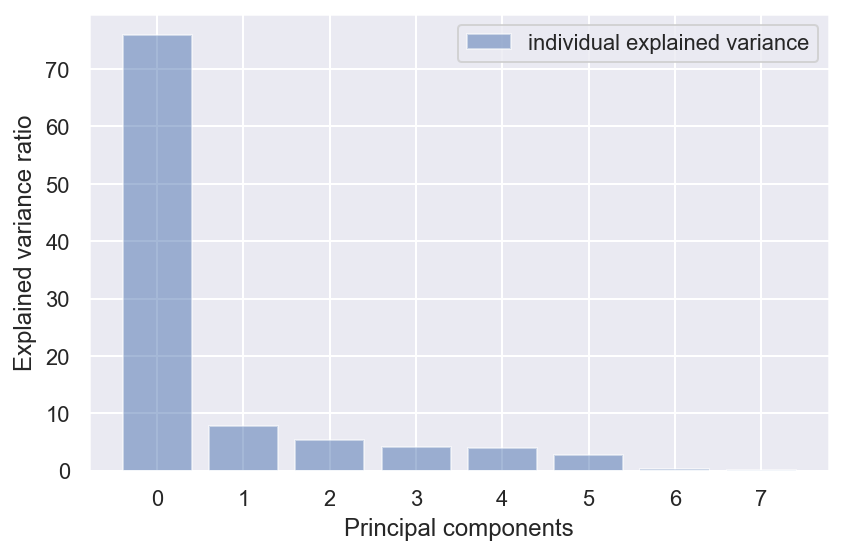

In [52]:
sns.set(font_scale=1)
plt.figure(figsize=(6, 4))

plt.bar(
    range(8), var_exp, alpha=0.5, align="center", label="individual explained variance"
)
plt.ylabel("Explained variance ratio")
plt.xlabel("Principal components")
plt.legend(loc="best")
plt.tight_layout()

Text(0, 0.5, 'Cumulative explained variance')

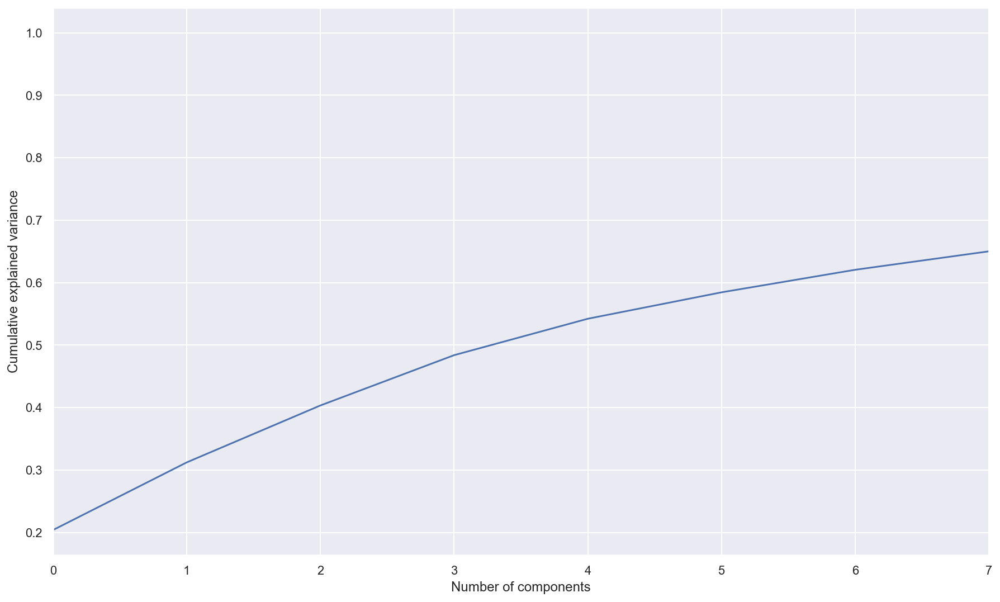

In [53]:
from sklearn.decomposition import PCA

pca = PCA().fit(X)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlim(0, 7, 1)
plt.xlabel("Number of components")
plt.ylabel("Cumulative explained variance")

## Hierarchal Clustering

### All training data:

In [54]:
def fancy_dendrogram(*args, **kwargs):
    max_d = kwargs.pop("max_d", None)
    if max_d and "color_threshold" not in kwargs:
        kwargs["color_threshold"] = max_d
    annotate_above = kwargs.pop("annotate_above", 0)
    plt.figure(figsize=(15, 10))
    ddata = dendrogram(*args, **kwargs)

    if not kwargs.get("no_plot", False):
        plt.title("Hierarchical Clustering Dendrogram (truncated)")
        plt.xlabel("sample index or (cluster size)")
        plt.ylabel("distance")
        for i, d, c in zip(ddata["icoord"], ddata["dcoord"], ddata["color_list"]):
            x = 0.5 * sum(i[1:3])
            y = d[1]
            if y > annotate_above:
                plt.plot(x, y, "o", c=c)
                plt.annotate(
                    "%.3g" % y,
                    (x, y),
                    xytext=(0, -5),
                    textcoords="offset points",
                    va="top",
                    ha="center",
                )
        if max_d:
            plt.axhline(y=max_d, c="k")
    return ddata

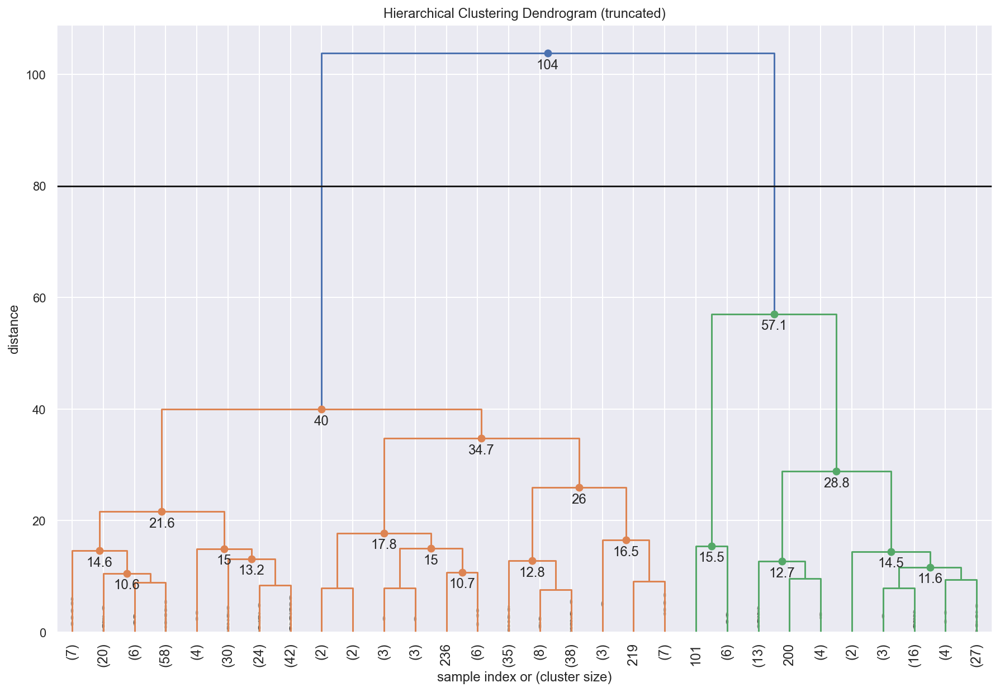

In [55]:
linked_array = ward(X2)

fancy_dendrogram(
    linked_array,
    truncate_mode="lastp",
    p=30,
    leaf_rotation=90.0,
    leaf_font_size=12.0,
    show_contracted=True,
    annotate_above=10,
    max_d=80,
)

plt.show()

In [56]:
# Reducing the dimensions of the data
pca = PCA(n_components=2)
X_principal = pca.fit_transform(X)
X_principal = pd.DataFrame(X_principal)
X_principal.columns = ["P1", "P2"]

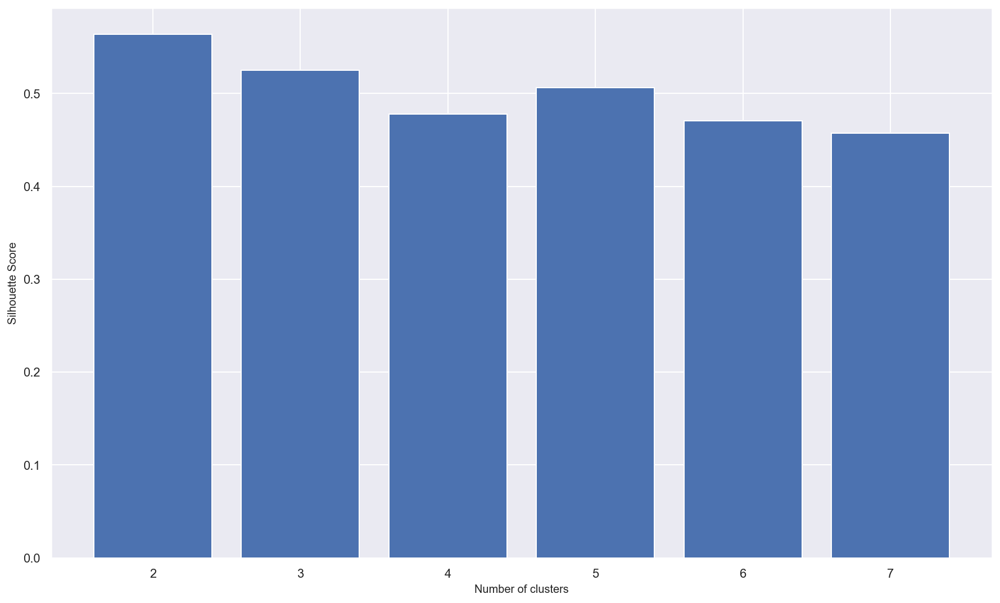

In [57]:
silhouette_scores = []

for n_cluster in range(2, 8):
    silhouette_scores.append(
        silhouette_score(
            X_principal,
            AgglomerativeClustering(n_clusters=n_cluster).fit_predict(X_principal),
        )
    )

# Plotting a bar graph to compare the results
k = [2, 3, 4, 5, 6, 7]
plt.bar(k, silhouette_scores)
plt.xlabel("Number of clusters", fontsize=10)
plt.ylabel("Silhouette Score", fontsize=10)
plt.show()

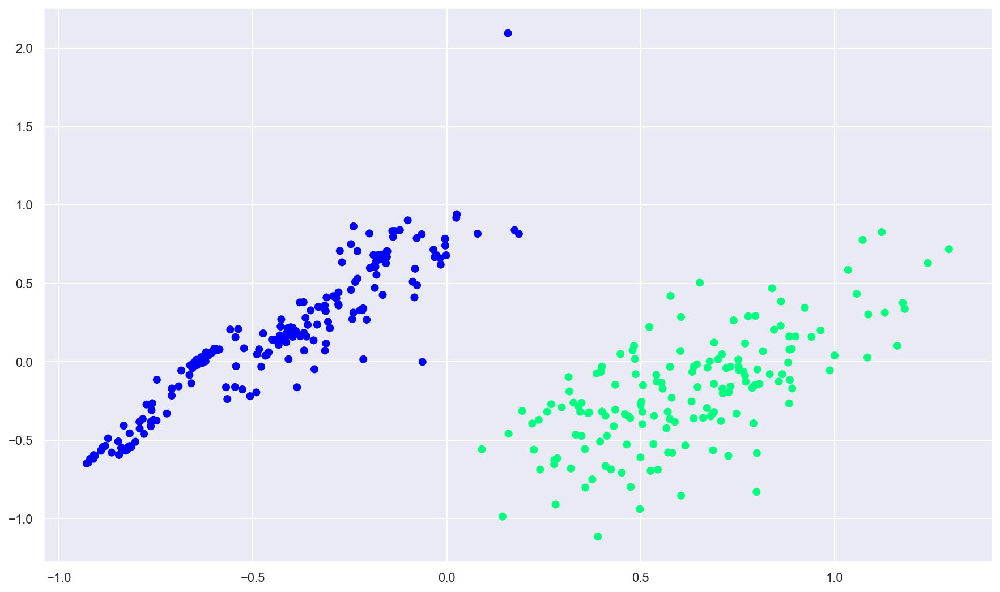

In [61]:
agg = AgglomerativeClustering(n_clusters=3)
agg.fit(X_principal)

sns.set(font_scale=1)
plt.scatter(
    X_principal["P1"],
    X_principal["P2"],
    c=AgglomerativeClustering(n_clusters=2).fit_predict(X_principal),
    cmap=plt.cm.winter,
)
plt.show()

### Elbow and silhouette scores - no PCA

Text(0, 0.5, 'Total within-cluster sum of squares')

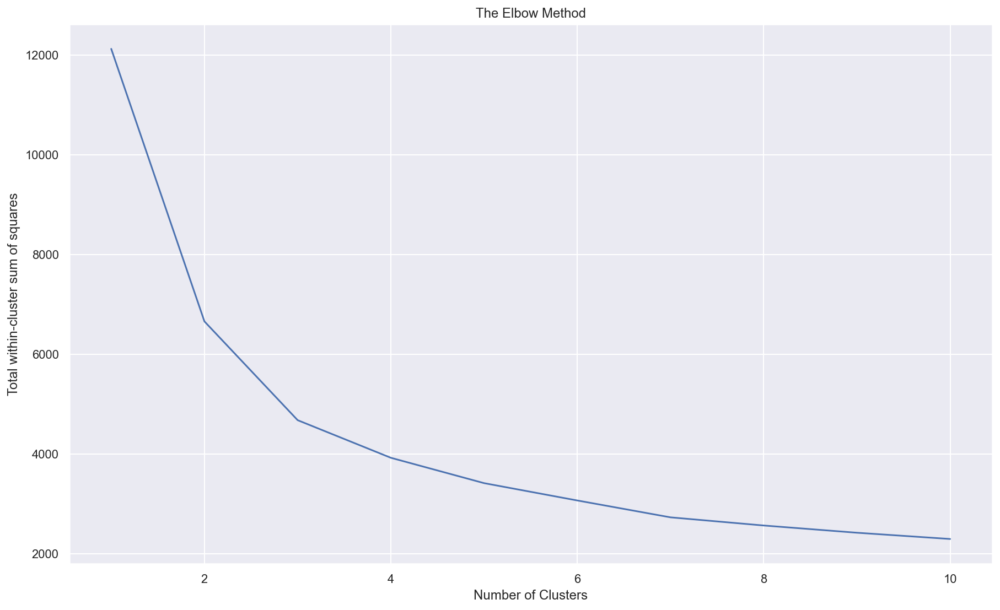

In [59]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

twss = []
sa = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init="k-means++")
    kmeans.fit(X2)
    Ypreds = kmeans.predict(X2)
    twss.append(kmeans.inertia_)
    if i > 1:
        sa.append(silhouette_score(X2, Ypreds))


plt.plot(range(1, 11), twss)
plt.title("The Elbow Method")
plt.xlabel("Number of Clusters")
plt.ylabel("Total within-cluster sum of squares")

Text(0, 0.5, 'Average silhouette score')

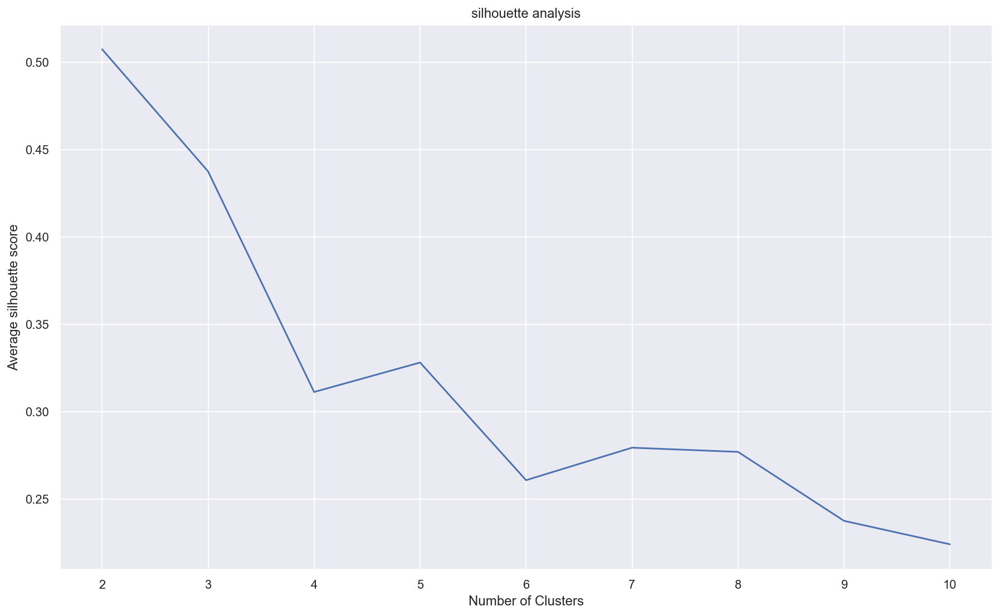

In [60]:
plt.plot(range(2, 11), sa)
plt.title("silhouette analysis")
plt.xlabel("Number of Clusters")
plt.ylabel("Average silhouette score")